<a href="https://colab.research.google.com/github/Maosef/498L_Final_Project/blob/master/dcgan_CIFAR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
%matplotlib inline


DCGAN Tutorial
==============

Based on the code by `Nathan Inkawhich <https://github.com/inkawhich>`__




In [0]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [0]:
# GPU details

print(torch.cuda.is_available())
print(torch.cuda.current_device())
print(torch.cuda.device_count())
print(torch.cuda.get_device_name(0))

True
0
1
Tesla P100-PCIE-16GB


## Hyperparameters
------

Let’s define some inputs for the run:

-  **dataroot** - the path to the root of the dataset folder. We will
   talk more about the dataset in the next section
-  **workers** - the number of worker threads for loading the data with
   the DataLoader
-  **batch_size** - the batch size used in training. The DCGAN paper
   uses a batch size of 128
-  **image_size** - the spatial size of the images used for training.
   This implementation defaults to 64x64. If another size is desired,
   the structures of D and G must be changed. See
   `here <https://github.com/pytorch/examples/issues/70>`__ for more
   details
-  **nc** - number of color channels in the input images. For color
   images this is 3
-  **nz** - length of latent vector
-  **ngf** - relates to the depth of feature maps carried through the
   generator
-  **ndf** - sets the depth of feature maps propagated through the
   discriminator
-  **num_epochs** - number of training epochs to run. Training for
   longer will probably lead to better results but will also take much
   longer
-  **lr** - learning rate for training. As described in the DCGAN paper,
   this number should be 0.0002
-  **beta1** - beta1 hyperparameter for Adam optimizers. As described in
   paper, this number should be 0.5
-  **ngpu** - number of GPUs available. If this is 0, code will run in
   CPU mode. If this number is greater than 0 it will run on that number
   of GPUs




In [0]:
# Root directory for dataset
dataroot = "/content/drive/My Drive/Colab Notebooks/celeba"
# dataroot = "data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 32

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 32

# Size of feature maps in discriminator
ndf = 32

# Number of training epochs
num_epochs = 240

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# model name
model_name = 'CIFAR_cats'

In [0]:
# from google.colab import drive
# drive.mount('/content/drive')
# %cd /content/drive/My Drive/Colab Notebooks

# !wget -c http://dl.yf.io/lsun/objects/cat.zip
# !unzip -d LSUN cat.zip

!df -h

Filesystem      Size  Used Avail Use% Mounted on
overlay          69G   32G   34G  49% /
tmpfs            64M     0   64M   0% /dev
tmpfs           6.4G     0  6.4G   0% /sys/fs/cgroup
shm             5.8G     0  5.8G   0% /dev/shm
tmpfs           6.4G   16K  6.4G   1% /var/colab
/dev/sda1        75G   33G   43G  44% /opt/bin
tmpfs           6.4G     0  6.4G   0% /proc/acpi
tmpfs           6.4G     0  6.4G   0% /proc/scsi
tmpfs           6.4G     0  6.4G   0% /sys/firmware


In [0]:
def filter_classes(dataset, class_id):
    dataset.targets = np.array(dataset.targets)
    idx = dataset.targets==class_id # cat=3
    print(idx)
    dataset.targets = dataset.targets[idx]
    print(dataset.data.shape)
    dataset.data = dataset.data[idx]
    # print(train_data.shape)

# !unzip '/content/drive/My Drive/Colab Notebooks/img_align_celeba.zip' -d '/content/drive/My Drive/Colab Notebooks/celeba'

[False False False ... False False False]
(50000, 32, 32, 3)
CPU times: user 2.35 s, sys: 977 ms, total: 3.32 s
Wall time: 3.67 s


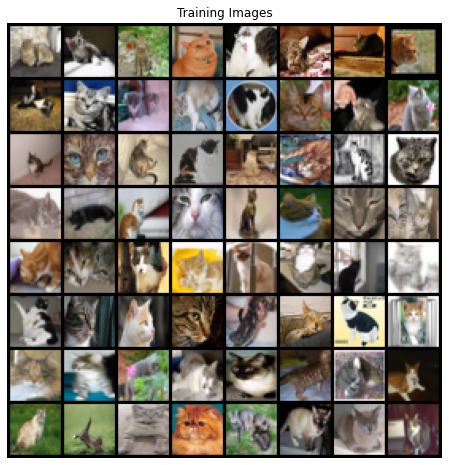

In [0]:
%%time

# We can use an image folder dataset the way we have it setup.
# Create the dataset
# dataset = dset.ImageFolder(root=dataroot,
#                            transform=transforms.Compose([
#                                transforms.Resize(image_size),
#                                transforms.CenterCrop(image_size),
#                                transforms.ToTensor(),
#                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
#                            ]))

# dataset = dset.MNIST(root=dataroot,
#                       transform=transforms.Compose([
#                           transforms.Resize(image_size),
#                           transforms.CenterCrop(image_size),
#                           transforms.ToTensor(),
#                           transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
#                       ]),
#                      download=True
#                      )

dataroot = "/content/drive/My Drive/Colab Notebooks/CIFAR"

dataset = dset.CIFAR10(root=dataroot,
                      transform=transforms.Compose([
                          transforms.ToTensor(),
                          transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                      ]),
                     download=False
                     )


filter_classes(dataset, 3)

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

5000
Counter({3: 5000})
[ True  True  True ...  True  True  True]
(5000, 32, 32, 3)
(5000, 32, 32, 3)
(32, 32, 3)


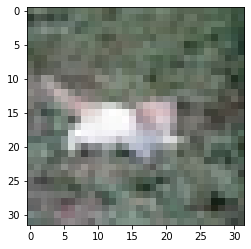

In [0]:
from collections import Counter

print(len(dataset))
print(Counter(dataset.targets))

dataset.targets = np.array(dataset.targets)
idx = dataset.targets==3 # cat
print(idx)
train_labels = dataset.targets[idx]
print(dataset.data.shape)
train_data = dataset.data[idx]
print(train_data.shape)

# print(train_data[0][1])
image = train_data[7]
print(image.shape)
plt.imshow(image)

In [0]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [0]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, nc, 4, 2, 1, bias=False),
            # nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ngf),
            # nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            # nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [0]:
# # Generator Code

# class Generator(nn.Module):
#     def __init__(self, ngpu):
#         super(Generator, self).__init__()
#         self.ngpu = ngpu
#         self.main = nn.Sequential(
#             # input is Z, going into a convolution
#             nn.ConvTranspose2d( nz, ngf * 4, 4, 1, 0, bias=False),
#             nn.BatchNorm2d(ngf * 4),
#             nn.ReLU(True),
#             # state size. (ngf*8) x 4 x 4
#             nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ngf * 2),
#             nn.ReLU(True),
#             # state size. (ngf*4) x 8 x 8
#             nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
#             nn.BatchNorm2d(ngf),
#             nn.ReLU(True),
#             # state size. (ngf*2) x 16 x 16
#             nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
#             # nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
#             # nn.BatchNorm2d(ngf),
#             # nn.ReLU(True),
#             # state size. (ngf) x 32 x 32
#             # nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
#             nn.Tanh()
#             # state size. (nc) x 64 x 64
#         )

#     def forward(self, input):
#         return self.main(input)

Discriminator Code



In [0]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            # nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            # nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            # nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            # nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Now, we can instantiate the generator and discriminator, apply the ``weights_init``
function, and print the model’s structure.




In [0]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)



# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)
Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(4, 4),

In [0]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [0]:
# tensorboard
from torch.utils.tensorboard import SummaryWriter

%load_ext tensorboard
%tensorboard --logdir=tb_log/CIFAR_cats # make sure to cd into the right place before


<IPython.core.display.Javascript object>

## Training

Starting Training Loop...
[0/240][0/40]	Loss_D: 1.7173	Loss_G: 2.3651	D(x): 0.9292	D(G(z)): 0.7460 / 0.1742


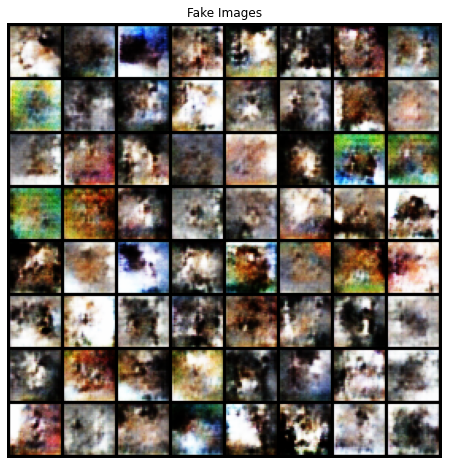

time (s):  1.6634242534637451
[1/240][0/40]	Loss_D: 0.6720	Loss_G: 1.7405	D(x): 0.6627	D(G(z)): 0.1501 / 0.2387
time (s):  1.2856597900390625
[2/240][0/40]	Loss_D: 0.7199	Loss_G: 1.7786	D(x): 0.6848	D(G(z)): 0.2570 / 0.2030
time (s):  1.2831175327301025
[3/240][0/40]	Loss_D: 0.8932	Loss_G: 1.8973	D(x): 0.8469	D(G(z)): 0.4806 / 0.1781
time (s):  1.2665979862213135
[4/240][0/40]	Loss_D: 0.8077	Loss_G: 1.5798	D(x): 0.5813	D(G(z)): 0.1732 / 0.2459
time (s):  1.2568597793579102
[5/240][0/40]	Loss_D: 1.3378	Loss_G: 2.9016	D(x): 0.9003	D(G(z)): 0.6482 / 0.0773
time (s):  1.265939712524414
[6/240][0/40]	Loss_D: 0.7177	Loss_G: 1.9738	D(x): 0.7935	D(G(z)): 0.3488 / 0.1681
time (s):  1.294111728668213
[7/240][0/40]	Loss_D: 0.8711	Loss_G: 1.8942	D(x): 0.5150	D(G(z)): 0.1106 / 0.2136
time (s):  1.331094741821289
[8/240][0/40]	Loss_D: 0.9498	Loss_G: 2.3634	D(x): 0.8124	D(G(z)): 0.4653 / 0.1224
time (s):  1.2872774600982666
[9/240][0/40]	Loss_D: 0.6291	Loss_G: 2.5827	D(x): 0.7868	D(G(z)): 0.2877 / 0.

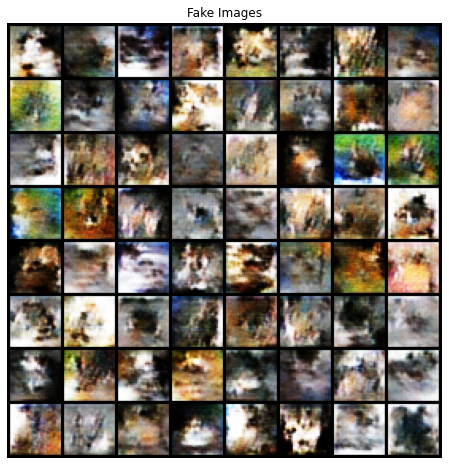

time (s):  1.5643811225891113
[13/240][0/40]	Loss_D: 0.9121	Loss_G: 1.3843	D(x): 0.6116	D(G(z)): 0.2839 / 0.2931
time (s):  1.2641737461090088
[14/240][0/40]	Loss_D: 2.7974	Loss_G: 2.3861	D(x): 0.9450	D(G(z)): 0.9002 / 0.1197
time (s):  1.3584437370300293
[15/240][0/40]	Loss_D: 1.2078	Loss_G: 2.3710	D(x): 0.7801	D(G(z)): 0.5428 / 0.1271
time (s):  1.3712210655212402
[16/240][0/40]	Loss_D: 1.0699	Loss_G: 1.3983	D(x): 0.5265	D(G(z)): 0.2701 / 0.2976
time (s):  1.3079724311828613
[17/240][0/40]	Loss_D: 1.0969	Loss_G: 2.0590	D(x): 0.7079	D(G(z)): 0.4663 / 0.1649
time (s):  1.2994208335876465
[18/240][0/40]	Loss_D: 0.8957	Loss_G: 1.0968	D(x): 0.5228	D(G(z)): 0.1621 / 0.3788
time (s):  1.2824468612670898
[19/240][0/40]	Loss_D: 1.1771	Loss_G: 2.4318	D(x): 0.8761	D(G(z)): 0.6001 / 0.1163
time (s):  1.2469251155853271
[20/240][0/40]	Loss_D: 0.6995	Loss_G: 1.7217	D(x): 0.6937	D(G(z)): 0.2480 / 0.2152
time (s):  1.2550110816955566
[21/240][0/40]	Loss_D: 1.0115	Loss_G: 2.5070	D(x): 0.7738	D(G(z)):

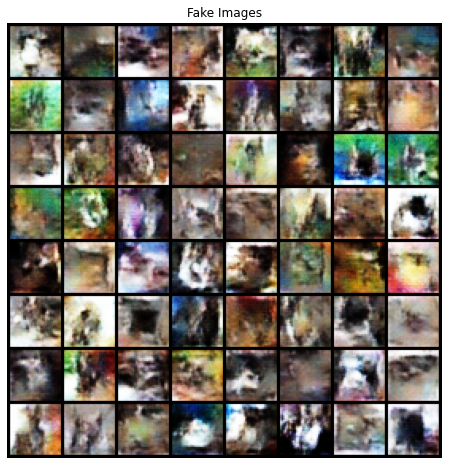

time (s):  1.5799009799957275
[26/240][0/40]	Loss_D: 1.0194	Loss_G: 1.3635	D(x): 0.5594	D(G(z)): 0.2674 / 0.3033
time (s):  1.2665965557098389
[27/240][0/40]	Loss_D: 0.9207	Loss_G: 1.3633	D(x): 0.6164	D(G(z)): 0.2968 / 0.3004
time (s):  1.2756481170654297
[28/240][0/40]	Loss_D: 1.3951	Loss_G: 2.1295	D(x): 0.9231	D(G(z)): 0.6714 / 0.1563
time (s):  1.2860944271087646
[29/240][0/40]	Loss_D: 1.2570	Loss_G: 2.2669	D(x): 0.8190	D(G(z)): 0.5750 / 0.1397
time (s):  1.2999331951141357
[30/240][0/40]	Loss_D: 0.8746	Loss_G: 2.0000	D(x): 0.8297	D(G(z)): 0.4542 / 0.1675
time (s):  1.3190534114837646
[31/240][0/40]	Loss_D: 0.9557	Loss_G: 1.5399	D(x): 0.6262	D(G(z)): 0.3406 / 0.2422
time (s):  1.2861242294311523
[32/240][0/40]	Loss_D: 1.3395	Loss_G: 2.9460	D(x): 0.8785	D(G(z)): 0.6493 / 0.0705
time (s):  1.2698397636413574
[33/240][0/40]	Loss_D: 0.8978	Loss_G: 2.2567	D(x): 0.7561	D(G(z)): 0.4155 / 0.1321
time (s):  1.2553727626800537
[34/240][0/40]	Loss_D: 1.0508	Loss_G: 2.9611	D(x): 0.8585	D(G(z)):

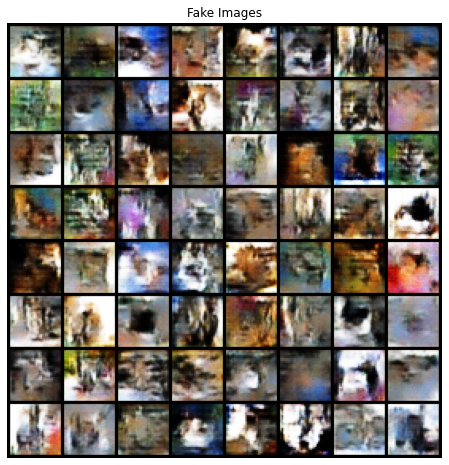

time (s):  1.5353407859802246
[38/240][0/40]	Loss_D: 1.0670	Loss_G: 1.7717	D(x): 0.7499	D(G(z)): 0.4998 / 0.2003
time (s):  1.3071420192718506
[39/240][0/40]	Loss_D: 1.1202	Loss_G: 1.8943	D(x): 0.7136	D(G(z)): 0.4914 / 0.1790
time (s):  1.287485122680664
[40/240][0/40]	Loss_D: 0.9615	Loss_G: 2.2452	D(x): 0.8033	D(G(z)): 0.4777 / 0.1292
time (s):  1.289212942123413
[41/240][0/40]	Loss_D: 1.1834	Loss_G: 1.9418	D(x): 0.8480	D(G(z)): 0.5848 / 0.1828
time (s):  1.2620518207550049
[42/240][0/40]	Loss_D: 0.9678	Loss_G: 2.0133	D(x): 0.8048	D(G(z)): 0.4839 / 0.1636
time (s):  1.2735741138458252
[43/240][0/40]	Loss_D: 1.0524	Loss_G: 0.9248	D(x): 0.4524	D(G(z)): 0.1412 / 0.4323
time (s):  1.2742626667022705
[44/240][0/40]	Loss_D: 1.7721	Loss_G: 2.2214	D(x): 0.9032	D(G(z)): 0.7654 / 0.1410
time (s):  1.2667579650878906
[45/240][0/40]	Loss_D: 0.8673	Loss_G: 1.5300	D(x): 0.7044	D(G(z)): 0.3542 / 0.2538
time (s):  1.2944977283477783
[46/240][0/40]	Loss_D: 1.2603	Loss_G: 2.4790	D(x): 0.8533	D(G(z)): 0

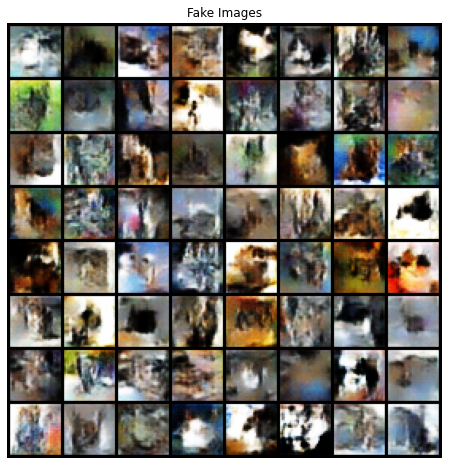

time (s):  1.5614705085754395
[51/240][0/40]	Loss_D: 1.1387	Loss_G: 1.2192	D(x): 0.4885	D(G(z)): 0.2804 / 0.3389
time (s):  1.325767993927002
[52/240][0/40]	Loss_D: 2.8845	Loss_G: 2.4185	D(x): 0.9681	D(G(z)): 0.9244 / 0.1199
time (s):  1.3077168464660645
[53/240][0/40]	Loss_D: 1.0846	Loss_G: 1.1419	D(x): 0.7303	D(G(z)): 0.5015 / 0.3477
time (s):  1.3291747570037842
[54/240][0/40]	Loss_D: 1.8752	Loss_G: 2.7485	D(x): 0.8543	D(G(z)): 0.7718 / 0.0820
time (s):  1.3169045448303223
[55/240][0/40]	Loss_D: 1.1036	Loss_G: 1.2666	D(x): 0.4332	D(G(z)): 0.1624 / 0.3257
time (s):  1.2927041053771973
[56/240][0/40]	Loss_D: 0.9626	Loss_G: 1.7372	D(x): 0.6744	D(G(z)): 0.3875 / 0.2065
time (s):  1.2822420597076416
[57/240][0/40]	Loss_D: 1.1598	Loss_G: 1.7939	D(x): 0.5871	D(G(z)): 0.4123 / 0.1948
time (s):  1.2766599655151367
[58/240][0/40]	Loss_D: 0.9950	Loss_G: 1.1931	D(x): 0.5744	D(G(z)): 0.2897 / 0.3465
time (s):  1.3319370746612549
[59/240][0/40]	Loss_D: 1.5248	Loss_G: 2.4688	D(x): 0.8259	D(G(z)): 

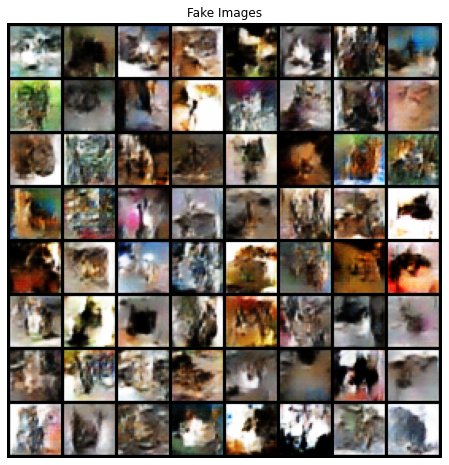

time (s):  1.8118112087249756
[63/240][0/40]	Loss_D: 0.9509	Loss_G: 1.8212	D(x): 0.8064	D(G(z)): 0.4854 / 0.1896
time (s):  1.3623394966125488
[64/240][0/40]	Loss_D: 0.7415	Loss_G: 1.7414	D(x): 0.8296	D(G(z)): 0.3961 / 0.2095
time (s):  1.3180789947509766
[65/240][0/40]	Loss_D: 0.8364	Loss_G: 1.7228	D(x): 0.6462	D(G(z)): 0.2891 / 0.2124
time (s):  1.3310377597808838
[66/240][0/40]	Loss_D: 1.4446	Loss_G: 2.3050	D(x): 0.9450	D(G(z)): 0.7053 / 0.1310
time (s):  1.2678816318511963
[67/240][0/40]	Loss_D: 1.0727	Loss_G: 2.4725	D(x): 0.7531	D(G(z)): 0.5138 / 0.0999
time (s):  1.3171467781066895
[68/240][0/40]	Loss_D: 2.5204	Loss_G: 3.1411	D(x): 0.9393	D(G(z)): 0.8839 / 0.0629
time (s):  1.2801480293273926
[69/240][0/40]	Loss_D: 1.1327	Loss_G: 2.1236	D(x): 0.8658	D(G(z)): 0.5868 / 0.1535
time (s):  1.2819232940673828
[70/240][0/40]	Loss_D: 1.1094	Loss_G: 2.0005	D(x): 0.8470	D(G(z)): 0.5680 / 0.1655
time (s):  1.3157856464385986
[71/240][0/40]	Loss_D: 0.9901	Loss_G: 0.9532	D(x): 0.4688	D(G(z)):

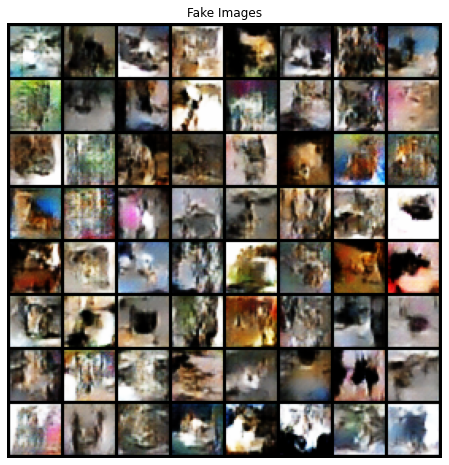

time (s):  1.53257417678833
[76/240][0/40]	Loss_D: 1.0078	Loss_G: 2.2030	D(x): 0.7443	D(G(z)): 0.4732 / 0.1292
time (s):  1.2928898334503174
[77/240][0/40]	Loss_D: 1.2114	Loss_G: 1.9458	D(x): 0.7885	D(G(z)): 0.5756 / 0.1715
time (s):  1.3104636669158936
[78/240][0/40]	Loss_D: 1.1072	Loss_G: 1.8617	D(x): 0.6870	D(G(z)): 0.4549 / 0.1941
time (s):  1.278543472290039
[79/240][0/40]	Loss_D: 0.9656	Loss_G: 1.7816	D(x): 0.8582	D(G(z)): 0.5238 / 0.1974
time (s):  1.2716152667999268
[80/240][0/40]	Loss_D: 1.1014	Loss_G: 1.1596	D(x): 0.5639	D(G(z)): 0.3332 / 0.3534
time (s):  1.2890467643737793
[81/240][0/40]	Loss_D: 0.9364	Loss_G: 1.6326	D(x): 0.6961	D(G(z)): 0.3887 / 0.2357
time (s):  1.2670085430145264
[82/240][0/40]	Loss_D: 1.2475	Loss_G: 1.6439	D(x): 0.8155	D(G(z)): 0.5975 / 0.2291
time (s):  1.3076715469360352
[83/240][0/40]	Loss_D: 0.9156	Loss_G: 1.7032	D(x): 0.7552	D(G(z)): 0.4209 / 0.2163
time (s):  1.2951693534851074
[84/240][0/40]	Loss_D: 1.7052	Loss_G: 2.2215	D(x): 0.9029	D(G(z)): 0.

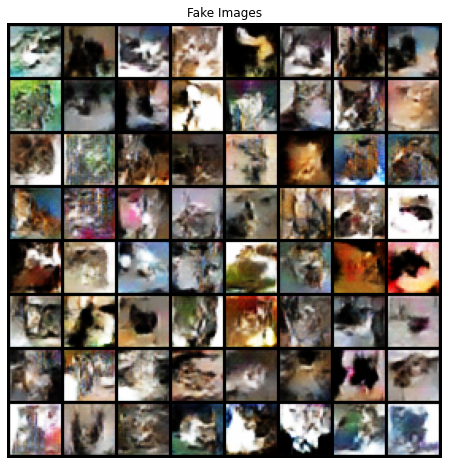

time (s):  1.541623592376709
[88/240][0/40]	Loss_D: 0.8615	Loss_G: 1.4605	D(x): 0.6422	D(G(z)): 0.3015 / 0.2705
time (s):  1.2739849090576172
[89/240][0/40]	Loss_D: 0.7541	Loss_G: 2.2367	D(x): 0.8807	D(G(z)): 0.4304 / 0.1310
time (s):  1.2788188457489014
[90/240][0/40]	Loss_D: 0.7526	Loss_G: 1.2855	D(x): 0.6944	D(G(z)): 0.2895 / 0.3088
time (s):  1.2883968353271484
[91/240][0/40]	Loss_D: 0.8954	Loss_G: 1.5821	D(x): 0.8116	D(G(z)): 0.4525 / 0.2483
time (s):  1.326157808303833
[92/240][0/40]	Loss_D: 0.9208	Loss_G: 1.5691	D(x): 0.7211	D(G(z)): 0.4105 / 0.2469
time (s):  1.2910981178283691
[93/240][0/40]	Loss_D: 1.6312	Loss_G: 2.1160	D(x): 0.8822	D(G(z)): 0.7281 / 0.1557
time (s):  1.2841687202453613
[94/240][0/40]	Loss_D: 0.6937	Loss_G: 2.0667	D(x): 0.7930	D(G(z)): 0.3334 / 0.1654
time (s):  1.2656562328338623
[95/240][0/40]	Loss_D: 1.0002	Loss_G: 0.7266	D(x): 0.5401	D(G(z)): 0.2612 / 0.5179
time (s):  1.281421184539795
[96/240][0/40]	Loss_D: 1.9340	Loss_G: 1.9587	D(x): 0.8489	D(G(z)): 0.

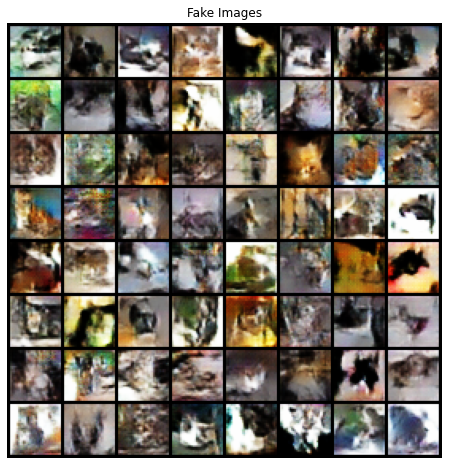

time (s):  1.5297634601593018
[101/240][0/40]	Loss_D: 0.8061	Loss_G: 2.3815	D(x): 0.7650	D(G(z)): 0.3661 / 0.1158
time (s):  1.2849440574645996
[102/240][0/40]	Loss_D: 1.2375	Loss_G: 2.1696	D(x): 0.8405	D(G(z)): 0.6117 / 0.1550
time (s):  1.2832005023956299
[103/240][0/40]	Loss_D: 1.6484	Loss_G: 0.9800	D(x): 0.2509	D(G(z)): 0.1040 / 0.4291
time (s):  1.2712490558624268
[104/240][0/40]	Loss_D: 0.9056	Loss_G: 1.9310	D(x): 0.8104	D(G(z)): 0.4615 / 0.1849
time (s):  1.2899203300476074
[105/240][0/40]	Loss_D: 0.8393	Loss_G: 1.8842	D(x): 0.7976	D(G(z)): 0.4221 / 0.1790
time (s):  1.2744743824005127
[106/240][0/40]	Loss_D: 2.4222	Loss_G: 2.9800	D(x): 0.9558	D(G(z)): 0.8561 / 0.0856
time (s):  1.382096290588379
[107/240][0/40]	Loss_D: 1.0165	Loss_G: 1.1170	D(x): 0.6600	D(G(z)): 0.4016 / 0.3743
time (s):  1.3073647022247314
[108/240][0/40]	Loss_D: 1.3689	Loss_G: 1.9836	D(x): 0.8408	D(G(z)): 0.6440 / 0.1818
time (s):  1.3071815967559814
[109/240][0/40]	Loss_D: 0.7556	Loss_G: 1.9231	D(x): 0.8008	

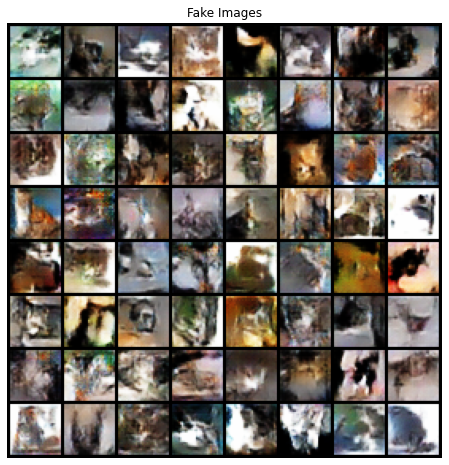

time (s):  1.59521484375
[113/240][0/40]	Loss_D: 0.6929	Loss_G: 1.5257	D(x): 0.6677	D(G(z)): 0.2077 / 0.2662
time (s):  1.3214170932769775
[114/240][0/40]	Loss_D: 1.0487	Loss_G: 1.3874	D(x): 0.5302	D(G(z)): 0.2631 / 0.2913
time (s):  1.3423950672149658
[115/240][0/40]	Loss_D: 1.0015	Loss_G: 0.5248	D(x): 0.5420	D(G(z)): 0.2386 / 0.6236
time (s):  1.2940232753753662
[116/240][0/40]	Loss_D: 1.1772	Loss_G: 2.3912	D(x): 0.8898	D(G(z)): 0.6100 / 0.1161
time (s):  1.293962001800537
[117/240][0/40]	Loss_D: 0.9077	Loss_G: 2.2217	D(x): 0.8116	D(G(z)): 0.4589 / 0.1317
time (s):  1.310068130493164
[118/240][0/40]	Loss_D: 1.0316	Loss_G: 2.2023	D(x): 0.7977	D(G(z)): 0.5012 / 0.1395
time (s):  1.2757184505462646
[119/240][0/40]	Loss_D: 1.3298	Loss_G: 2.7658	D(x): 0.8879	D(G(z)): 0.6427 / 0.0940
time (s):  1.284071683883667
[120/240][0/40]	Loss_D: 0.8385	Loss_G: 1.6009	D(x): 0.7597	D(G(z)): 0.3914 / 0.2363
time (s):  1.2584760189056396
[121/240][0/40]	Loss_D: 0.9031	Loss_G: 1.9318	D(x): 0.7521	D(G(z))

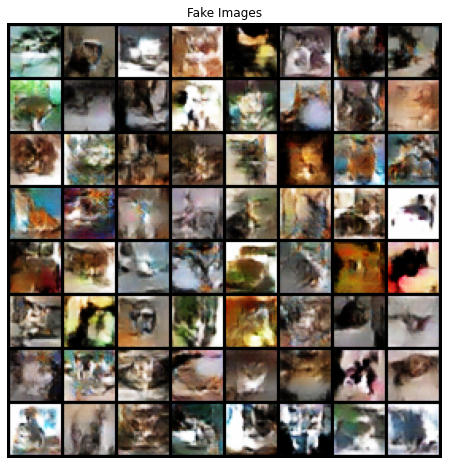

time (s):  1.5352346897125244
[126/240][0/40]	Loss_D: 1.4866	Loss_G: 2.6870	D(x): 0.8701	D(G(z)): 0.6797 / 0.1000
time (s):  1.3152120113372803
[127/240][0/40]	Loss_D: 1.2191	Loss_G: 1.7485	D(x): 0.6865	D(G(z)): 0.5059 / 0.2159
time (s):  1.3055024147033691
[128/240][0/40]	Loss_D: 1.5015	Loss_G: 2.6618	D(x): 0.9144	D(G(z)): 0.6810 / 0.1145
time (s):  1.3105130195617676
[129/240][0/40]	Loss_D: 0.8577	Loss_G: 1.7482	D(x): 0.6240	D(G(z)): 0.2645 / 0.2174
time (s):  1.312258243560791
[130/240][0/40]	Loss_D: 1.1729	Loss_G: 2.7538	D(x): 0.8568	D(G(z)): 0.5713 / 0.0851
time (s):  1.282677412033081
[131/240][0/40]	Loss_D: 1.7182	Loss_G: 1.9179	D(x): 0.9207	D(G(z)): 0.7596 / 0.1838
time (s):  1.2871131896972656
[132/240][0/40]	Loss_D: 1.1551	Loss_G: 2.3825	D(x): 0.8923	D(G(z)): 0.5954 / 0.1156
time (s):  1.3140232563018799
[133/240][0/40]	Loss_D: 1.0209	Loss_G: 1.0981	D(x): 0.5235	D(G(z)): 0.2161 / 0.3873
time (s):  1.2975497245788574
[134/240][0/40]	Loss_D: 1.3867	Loss_G: 2.4326	D(x): 0.9073	D

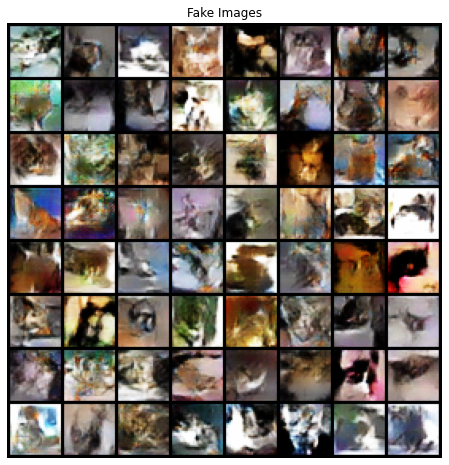

time (s):  1.5667014122009277
[138/240][0/40]	Loss_D: 0.6716	Loss_G: 2.4263	D(x): 0.8585	D(G(z)): 0.3693 / 0.1180
time (s):  1.2600305080413818
[139/240][0/40]	Loss_D: 1.2940	Loss_G: 2.6411	D(x): 0.9097	D(G(z)): 0.6518 / 0.0930
time (s):  1.2744817733764648
[140/240][0/40]	Loss_D: 1.2673	Loss_G: 2.1365	D(x): 0.7920	D(G(z)): 0.5943 / 0.1511
time (s):  1.2957422733306885
[141/240][0/40]	Loss_D: 0.7764	Loss_G: 2.1283	D(x): 0.8465	D(G(z)): 0.4164 / 0.1525
time (s):  1.2778608798980713
[142/240][0/40]	Loss_D: 0.7428	Loss_G: 2.0541	D(x): 0.8140	D(G(z)): 0.3821 / 0.1602
time (s):  1.274477243423462
[143/240][0/40]	Loss_D: 1.0696	Loss_G: 2.9630	D(x): 0.7976	D(G(z)): 0.5262 / 0.0692
time (s):  1.3302431106567383
[144/240][0/40]	Loss_D: 1.0790	Loss_G: 2.5765	D(x): 0.8793	D(G(z)): 0.5651 / 0.0995
time (s):  1.2978343963623047
[145/240][0/40]	Loss_D: 1.1217	Loss_G: 1.8874	D(x): 0.8265	D(G(z)): 0.5512 / 0.1854
time (s):  1.2752928733825684
[146/240][0/40]	Loss_D: 1.2032	Loss_G: 2.8104	D(x): 0.8672	

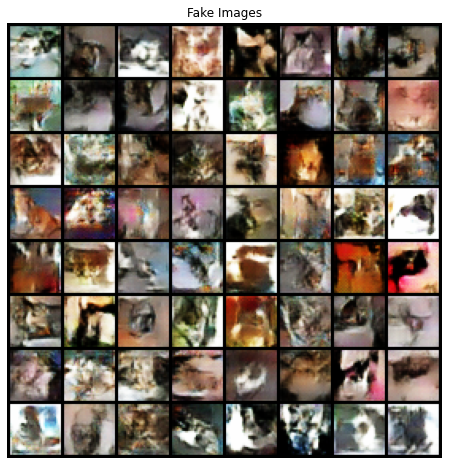

time (s):  1.548966884613037
[151/240][0/40]	Loss_D: 0.8512	Loss_G: 2.0416	D(x): 0.8483	D(G(z)): 0.4626 / 0.1565
time (s):  1.256568193435669
[152/240][0/40]	Loss_D: 0.9496	Loss_G: 2.9920	D(x): 0.9059	D(G(z)): 0.5440 / 0.0677
time (s):  1.3009922504425049
[153/240][0/40]	Loss_D: 1.2630	Loss_G: 2.9117	D(x): 0.9115	D(G(z)): 0.6384 / 0.0745
time (s):  1.2609350681304932
[154/240][0/40]	Loss_D: 0.7935	Loss_G: 2.2970	D(x): 0.8629	D(G(z)): 0.4338 / 0.1281
time (s):  1.2859666347503662
[155/240][0/40]	Loss_D: 0.8467	Loss_G: 1.9019	D(x): 0.7578	D(G(z)): 0.4005 / 0.1795
time (s):  1.3442320823669434
[156/240][0/40]	Loss_D: 1.3146	Loss_G: 2.2598	D(x): 0.8428	D(G(z)): 0.6048 / 0.1449
time (s):  1.2551004886627197
[157/240][0/40]	Loss_D: 0.8394	Loss_G: 2.9356	D(x): 0.8700	D(G(z)): 0.4661 / 0.0743
time (s):  1.2940526008605957
[158/240][0/40]	Loss_D: 1.8329	Loss_G: 2.1813	D(x): 0.7689	D(G(z)): 0.7455 / 0.1424
time (s):  1.3116836547851562
[159/240][0/40]	Loss_D: 1.1007	Loss_G: 1.8284	D(x): 0.7969	D

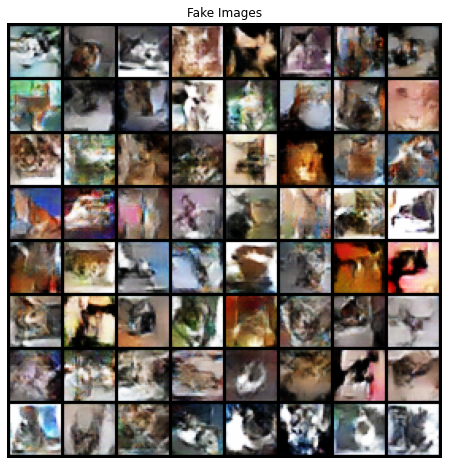

time (s):  1.5828502178192139
[163/240][0/40]	Loss_D: 0.9098	Loss_G: 3.3674	D(x): 0.8624	D(G(z)): 0.4870 / 0.0490
time (s):  1.2879583835601807
[164/240][0/40]	Loss_D: 1.3313	Loss_G: 2.7015	D(x): 0.8701	D(G(z)): 0.6383 / 0.0902
time (s):  1.2919485569000244
[165/240][0/40]	Loss_D: 1.0759	Loss_G: 1.2987	D(x): 0.4980	D(G(z)): 0.2390 / 0.3186
time (s):  1.307532548904419
[166/240][0/40]	Loss_D: 1.7741	Loss_G: 2.2440	D(x): 0.9558	D(G(z)): 0.7640 / 0.1544
time (s):  1.2923486232757568
[167/240][0/40]	Loss_D: 1.6873	Loss_G: 3.7174	D(x): 0.8915	D(G(z)): 0.7257 / 0.0369
time (s):  1.324012279510498
[168/240][0/40]	Loss_D: 0.8103	Loss_G: 1.6781	D(x): 0.7012	D(G(z)): 0.3121 / 0.2385
time (s):  1.3019218444824219
[169/240][0/40]	Loss_D: 1.1130	Loss_G: 2.7081	D(x): 0.8871	D(G(z)): 0.5713 / 0.0918
time (s):  1.2942121028900146
[170/240][0/40]	Loss_D: 0.8741	Loss_G: 1.1000	D(x): 0.5500	D(G(z)): 0.1980 / 0.3713
time (s):  1.3190553188323975
[171/240][0/40]	Loss_D: 0.8939	Loss_G: 2.4084	D(x): 0.8120	D

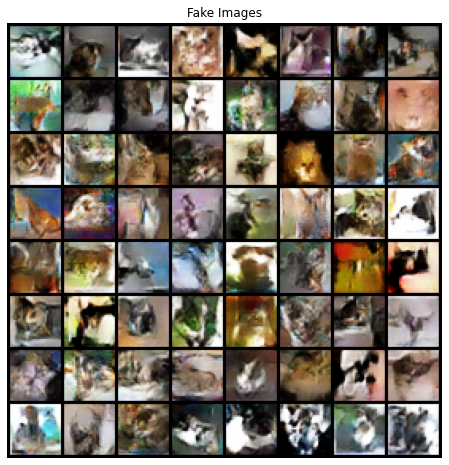

time (s):  1.5725617408752441
[176/240][0/40]	Loss_D: 1.0228	Loss_G: 0.9255	D(x): 0.4958	D(G(z)): 0.1915 / 0.4495
time (s):  1.3104841709136963
[177/240][0/40]	Loss_D: 0.9145	Loss_G: 1.1190	D(x): 0.4921	D(G(z)): 0.1211 / 0.3767
time (s):  1.3154187202453613
[178/240][0/40]	Loss_D: 0.6253	Loss_G: 1.7209	D(x): 0.6534	D(G(z)): 0.1430 / 0.2273
time (s):  1.2826476097106934
[179/240][0/40]	Loss_D: 2.9225	Loss_G: 0.7567	D(x): 0.0830	D(G(z)): 0.0173 / 0.5292
time (s):  1.3165271282196045
[180/240][0/40]	Loss_D: 1.0420	Loss_G: 1.1021	D(x): 0.4552	D(G(z)): 0.1382 / 0.3970
time (s):  1.3160734176635742
[181/240][0/40]	Loss_D: 1.3558	Loss_G: 3.0302	D(x): 0.9524	D(G(z)): 0.6618 / 0.0834
time (s):  1.2717926502227783
[182/240][0/40]	Loss_D: 0.9602	Loss_G: 2.4332	D(x): 0.9114	D(G(z)): 0.5116 / 0.1238
time (s):  1.3266069889068604
[183/240][0/40]	Loss_D: 0.6985	Loss_G: 2.7347	D(x): 0.8802	D(G(z)): 0.3945 / 0.0915
time (s):  1.285510778427124
[184/240][0/40]	Loss_D: 0.7859	Loss_G: 3.0963	D(x): 0.9513	

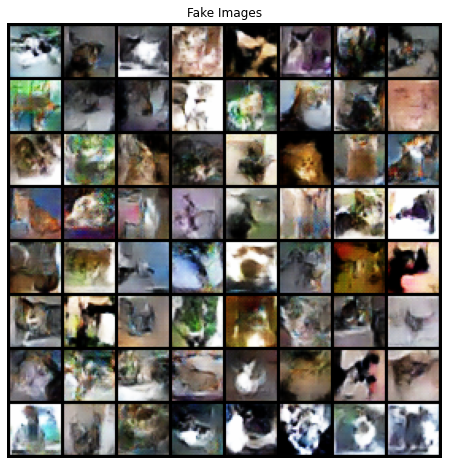

time (s):  1.5897393226623535
[188/240][0/40]	Loss_D: 0.6267	Loss_G: 2.8990	D(x): 0.8883	D(G(z)): 0.3590 / 0.0741
time (s):  1.2910981178283691
[189/240][0/40]	Loss_D: 0.6159	Loss_G: 1.6945	D(x): 0.7475	D(G(z)): 0.2518 / 0.2225
time (s):  1.2875850200653076
[190/240][0/40]	Loss_D: 0.6599	Loss_G: 1.1534	D(x): 0.6472	D(G(z)): 0.1620 / 0.3678
time (s):  1.338683843612671
[191/240][0/40]	Loss_D: 2.1046	Loss_G: 3.5122	D(x): 0.9697	D(G(z)): 0.8194 / 0.0544
time (s):  1.3029921054840088
[192/240][0/40]	Loss_D: 0.7337	Loss_G: 2.2387	D(x): 0.7754	D(G(z)): 0.3480 / 0.1395
time (s):  1.296966314315796
[193/240][0/40]	Loss_D: 1.6359	Loss_G: 2.5773	D(x): 0.9447	D(G(z)): 0.7153 / 0.1126
time (s):  1.3038783073425293
[194/240][0/40]	Loss_D: 0.8852	Loss_G: 2.2209	D(x): 0.7874	D(G(z)): 0.4164 / 0.1489
time (s):  1.2903907299041748
[195/240][0/40]	Loss_D: 1.3993	Loss_G: 3.0626	D(x): 0.9129	D(G(z)): 0.6657 / 0.0686
time (s):  1.3248002529144287
[196/240][0/40]	Loss_D: 1.1121	Loss_G: 2.7080	D(x): 0.8822	D

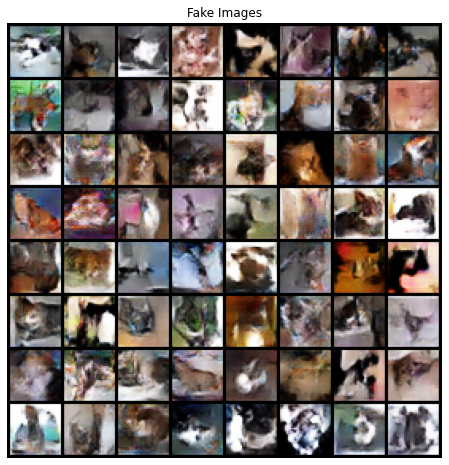

time (s):  1.5857758522033691
[201/240][0/40]	Loss_D: 0.7850	Loss_G: 2.9826	D(x): 0.8460	D(G(z)): 0.4054 / 0.0734
time (s):  1.3456940650939941
[202/240][0/40]	Loss_D: 0.7272	Loss_G: 2.3417	D(x): 0.8657	D(G(z)): 0.3966 / 0.1372
time (s):  1.3046824932098389
[203/240][0/40]	Loss_D: 2.5025	Loss_G: 2.2071	D(x): 0.9846	D(G(z)): 0.8883 / 0.1764
time (s):  1.301023244857788
[204/240][0/40]	Loss_D: 1.3781	Loss_G: 3.3588	D(x): 0.9910	D(G(z)): 0.6845 / 0.0631
time (s):  1.3069663047790527
[205/240][0/40]	Loss_D: 1.2073	Loss_G: 3.1197	D(x): 0.8757	D(G(z)): 0.5855 / 0.0767
time (s):  1.3141632080078125
[206/240][0/40]	Loss_D: 0.8194	Loss_G: 2.5854	D(x): 0.8975	D(G(z)): 0.4547 / 0.1107
time (s):  1.306044101715088
[207/240][0/40]	Loss_D: 0.6506	Loss_G: 2.3527	D(x): 0.7876	D(G(z)): 0.2958 / 0.1239
time (s):  1.302560567855835
[208/240][0/40]	Loss_D: 1.8486	Loss_G: 3.4265	D(x): 0.9183	D(G(z)): 0.7325 / 0.0653
time (s):  1.2958924770355225
[209/240][0/40]	Loss_D: 0.8048	Loss_G: 2.5470	D(x): 0.9367	D(

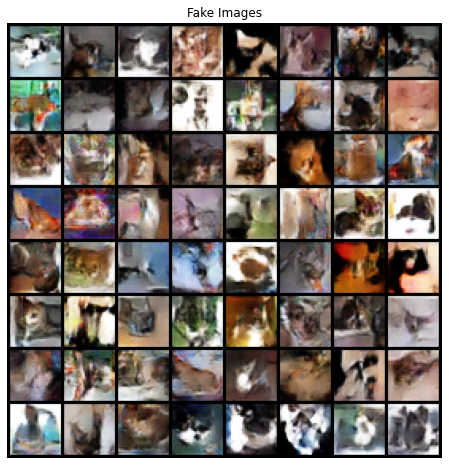

time (s):  1.5854072570800781
[213/240][0/40]	Loss_D: 0.5886	Loss_G: 1.6699	D(x): 0.6416	D(G(z)): 0.0982 / 0.2478
time (s):  1.3018360137939453
[214/240][0/40]	Loss_D: 0.7691	Loss_G: 2.7069	D(x): 0.8950	D(G(z)): 0.4327 / 0.0919
time (s):  1.303576946258545
[215/240][0/40]	Loss_D: 1.6272	Loss_G: 3.3694	D(x): 0.8832	D(G(z)): 0.6980 / 0.0530
time (s):  1.3310356140136719
[216/240][0/40]	Loss_D: 3.1836	Loss_G: 5.0452	D(x): 0.9866	D(G(z)): 0.9202 / 0.0145
time (s):  1.3141441345214844
[217/240][0/40]	Loss_D: 0.8288	Loss_G: 2.8145	D(x): 0.8891	D(G(z)): 0.4355 / 0.0957
time (s):  1.3077192306518555
[218/240][0/40]	Loss_D: 0.9975	Loss_G: 2.4878	D(x): 0.9564	D(G(z)): 0.5674 / 0.1152
time (s):  1.3355391025543213
[219/240][0/40]	Loss_D: 0.6645	Loss_G: 2.5062	D(x): 0.8057	D(G(z)): 0.3121 / 0.1209
time (s):  1.3081257343292236
[220/240][0/40]	Loss_D: 0.5983	Loss_G: 2.3360	D(x): 0.7958	D(G(z)): 0.2796 / 0.1334
time (s):  1.3420155048370361
[221/240][0/40]	Loss_D: 0.4425	Loss_G: 2.2974	D(x): 0.8058	

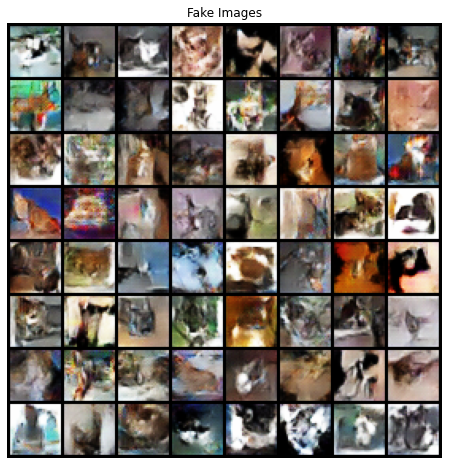

time (s):  1.5850639343261719
[226/240][0/40]	Loss_D: 0.9452	Loss_G: 3.2564	D(x): 0.8836	D(G(z)): 0.5102 / 0.0559
time (s):  1.3219683170318604
[227/240][0/40]	Loss_D: 0.5697	Loss_G: 2.1692	D(x): 0.8109	D(G(z)): 0.2580 / 0.1507
time (s):  1.3373730182647705
[228/240][0/40]	Loss_D: 0.5102	Loss_G: 2.4584	D(x): 0.8188	D(G(z)): 0.2306 / 0.1284
time (s):  1.317817211151123
[229/240][0/40]	Loss_D: 0.6073	Loss_G: 1.5178	D(x): 0.6795	D(G(z)): 0.1661 / 0.2704
time (s):  1.332967758178711
[230/240][0/40]	Loss_D: 0.5848	Loss_G: 1.6684	D(x): 0.7386	D(G(z)): 0.2089 / 0.2414
time (s):  1.3309354782104492
[231/240][0/40]	Loss_D: 2.1750	Loss_G: 1.7949	D(x): 0.9771	D(G(z)): 0.7649 / 0.2799
time (s):  1.3537700176239014
[232/240][0/40]	Loss_D: 0.9344	Loss_G: 2.8412	D(x): 0.9204	D(G(z)): 0.5069 / 0.0894
time (s):  1.3169724941253662
[233/240][0/40]	Loss_D: 0.5025	Loss_G: 2.0874	D(x): 0.7516	D(G(z)): 0.1644 / 0.1674
time (s):  1.3302509784698486
[234/240][0/40]	Loss_D: 0.8410	Loss_G: 3.2225	D(x): 0.8540	D

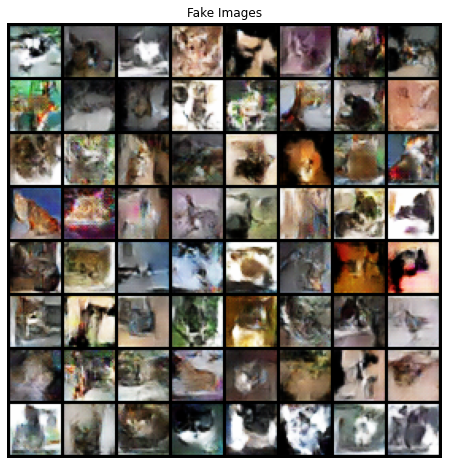

time (s):  1.5824010372161865
[238/240][0/40]	Loss_D: 0.6797	Loss_G: 2.4005	D(x): 0.7457	D(G(z)): 0.2579 / 0.1445
time (s):  1.3765974044799805
[239/240][0/40]	Loss_D: 0.8573	Loss_G: 3.2110	D(x): 0.9049	D(G(z)): 0.4789 / 0.0574


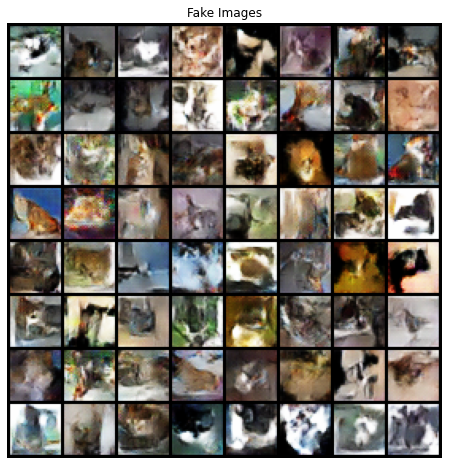

time (s):  1.572533130645752
CPU times: user 2min 36s, sys: 32.8 s, total: 3min 9s
Wall time: 5min 27s


In [0]:
%%time

import time

model_path = "/content/drive/My Drive/Colab Notebooks/GAN models/"

# load model
# model = TheModelClass(*args, **kwargs)
# model.load_state_dict(torch.load(PATH))
# model.eval()

best_loss = np.inf

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

summary_writer = SummaryWriter(log_dir="tb_log/{}".format(model_name if len(model_name) else None ))

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    start = time.time()
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            summary_writer.add_scalar("loss/D",errD.item(), epoch*821 + i) # add train loss to tensorboard
            summary_writer.add_scalar("loss/G",errG.item(), epoch*821 + i) # add train loss to tensorboard


        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            # Plot the fake images from the last epoch
            plt.figure(figsize=(8,8))
            plt.axis("off")
            plt.title("Fake Images")
            plt.imshow(np.transpose(img_list[-1],(1,2,0)))
            plt.show()
            
        iters += 1

    print("time (s): ",time.time()-start)
    # save models
    torch.save(netD.state_dict(), model_path + model_name)
    torch.save(netG.state_dict(), model_path + model_name)


Results
-------

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G’s losses changed
during training. Second, we will visualize G’s output on the fixed_noise
batch for every epoch. And third, we will look at a batch of real data
next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G’s losses versus training iterations.




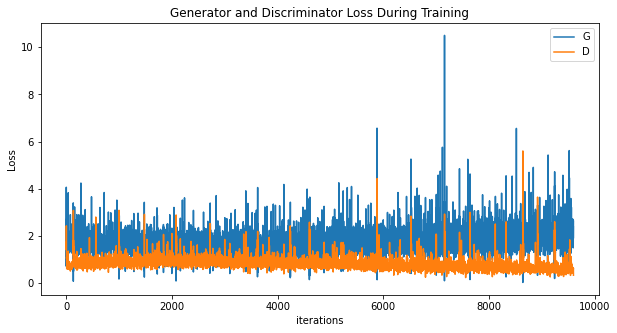

In [0]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

lets take a look at some real images and fake images side by
side.

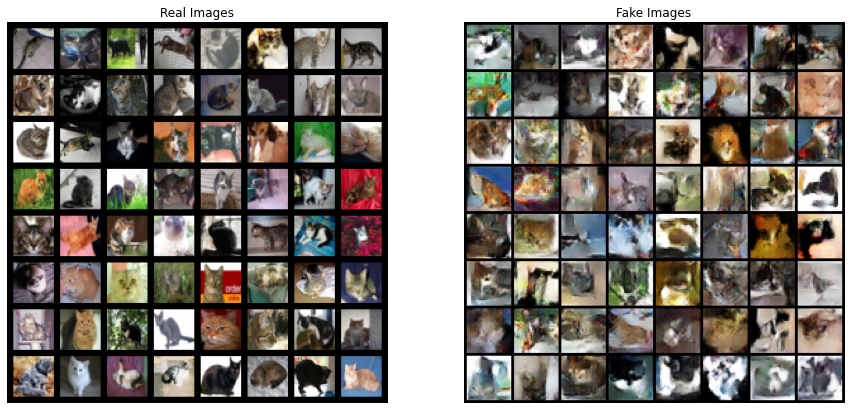

In [0]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

**Visualization of G’s progression**

Remember how we saved the generator’s output on the fixed_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.




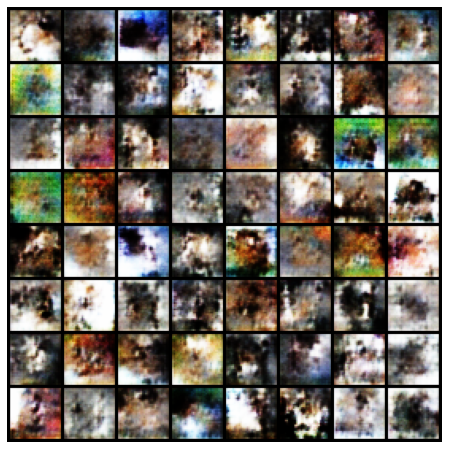

In [0]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Where to Go Next
----------------

We have reached the end of our journey, but there are several places you
could go from here. You could:

-  Train for longer to see how good the results get
-  Modify this model to take a different dataset and possibly change the
   size of the images and the model architecture
-  Check out some other cool GAN projects
   `here <https://github.com/nashory/gans-awesome-applications>`__
-  Create GANs that generate
   `music <https://deepmind.com/blog/wavenet-generative-model-raw-audio/>`__


